# Jupyter Demo of how Stitching works

*This does not support the manual GUI*

### Dependencies
Post_Processing handles stacking, automatic alignment, and rendering to a file.

In [1]:
import Post_Processing as Post
import glob

In [2]:
img_glob = "Test_*.png"

### Grabbing filenames
We want to take filenames matching the specified pattern, in alphabetical order.

In [3]:
img_list = glob.glob(img_glob)
img_list.sort()

print(img_list)

['Test_A.png', 'Test_B.png', 'Test_C.png', 'Test_D.png']


### Constructing a Stack
In this case, a Stack is the term for files in order. We want to put each file onto the stack, in order, with a default relative alignment of (0, 0).

In [4]:
stack = Post.Stack()
for filename in img_list:
    stack.register(filename, [0, 0])

### Aligning the Images

The first thing we want to do is create alignments for each image. This takes a few seconds because the software will get a pixel-perfect alignment.
If you're running this on GitHub, please be patient with free web hosting. The usual number of iterations is around 20.

In [5]:
stack.align()

Creating Alignment for: Creating Alignment for: Creating Alignment for:    Test_C.pngTest_A.pngTest_B.png   Test_D.pngTest_B.pngTest_C.png


[run_optimize] optimize...[run_optimize] optimize...
[run_optimize] optimize...


[ITER] 0 for Test_B.png

[ITER] 0 for Test_D.png
[ITER] 1 for Test_B.png


[ITER] 1 for Test_D.png

[ITER] 0 for Test_C.png

[ITER] 1 for Test_C.png
[Test_B.png]		New Transform: [-0.030, 0.000]
[Test_B.png]		Org Transform: [0.000, 0.000]

[ITER] 2 for Test_B.png
[ITER] 2 for Test_D.png

[Test_B.png]		New Transform: [-0.060, 0.000]
[Test_D.png]		New Transform: [-0.020, 0.000][Test_B.png]		Org Transform: [0.000, 0.000]

[Test_D.png]		Org Transform: [0.000, 0.000]
[ITER] 3 for Test_B.png


[ITER] 3 for Test_D.png[Test_C.png]		New Transform: [-0.030, 0.000]

[Test_C.png]		Org Transform: [0.000, 0.000]
[ITER] 4 for Test_B.png
[Test_D.png]		New Transform: [-0.050, 0.000]


[ITER] 2 for Test_C.png[Test_D.png]		Org Transform: [0.000, 0.000]


[ITER] 4 for Test_D.png
[ITER] 5

### Calculating global alignments
Now that we have relative alignments for each image (one image offset relative to it's previous), we need to stitch those together into 'global' transforms relative to the output image space.

In [6]:
stack.construct_global_alignments()

Done Loading
Final Width:   5295
Final Height:  2992


# Output
Finally, we generate our completed image.

In [7]:
final_img = stack.output("Jupyter_Out.png", return_when_done = True)

Pasting
	Pasting Image  Test_A.png
	Transform:  [0, 0]
	Pasting Image  Test_B.png
	Transform:  [-308.0, -32.0]
	Pasting Image  Test_C.png
	Transform:  [-632.0, -80.0]
	Pasting Image  Test_D.png
	Transform:  [-1005.3333333333334, -136.0]


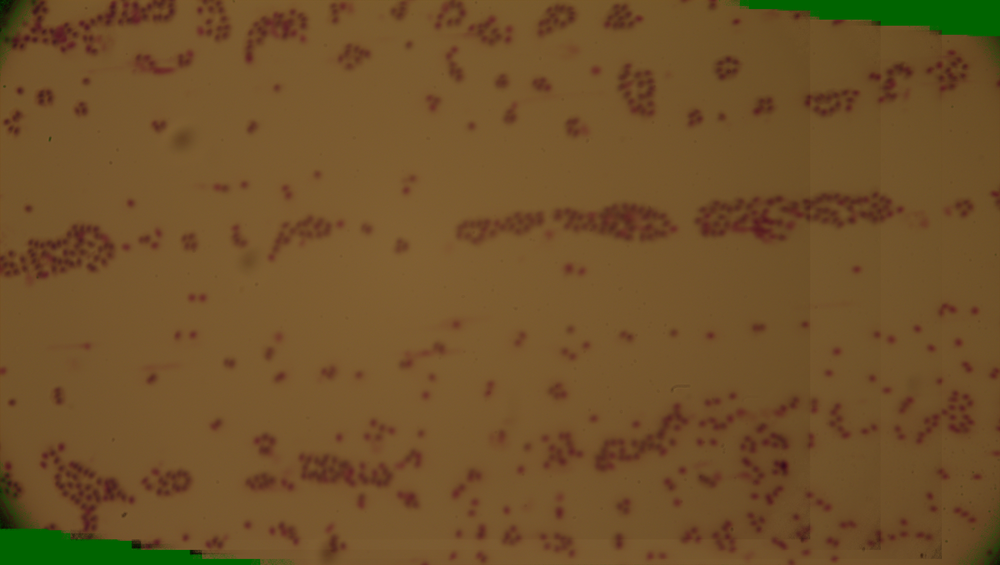

In [10]:
from IPython.display import Image
display(final_img)

## Review
Obviously, this isn't perfect. The green background is intentional, it essentially shows where transparency would be (remember, the sofware identifies and removes dust particles). The graininess of dust removal is a known issue and is under development. Completing that development should also increase the dust rejection capabilities.

Other than that, the images should be perfectly aligned!

# How does it work?

## Alignment
For a pair of sequential images:
1. Both images are downsized significantly - down to around 2^4 pixels wide.
2. The R^2 errors for a 3x3 window of alignments are computed.
3. The transform is adjusted towards the direction with minimum error.
4. When the current transform is the best one (compared against a small and a larger window), the downsize scale is reduced by a power of two and the process is repeated.

This allows for very fast solutions to rough alignment, and for a very short time to be spent moving around full-size images. The rough alignments run quickly enough to provide alignments in real time between images as they're taken.

## Dust Rejection
Starting from properly aligned images, pixels which have a consistantly high error in the 'field' space (the coordinates within each image) are identified and rejected, as they appear to travel with the camera rather than the subject.